## **DS 5110: Big Data Systems | Final Project**
## **State of Virginia Traffic Reliability | MAP21**

### by Christian Schroeder (dbn5eu), Timothy Tyree (twt6xy), Colin Warner (ynq9ya)

---

## **Brief Overview**

**Project Description:** This study develops a target setting methodology for the (Moving Ahead for Progress) MAP-21 Interstate Travel Time Reliability Measure of “Percent of the person-miles traveled on the Interstate that are Reliable” (PMTR-IS). The study uses Virginia specific data for a set of independent variables (Number of Lanes, Terrain, Urban Designation, Equivalent Property Damage Only Rate, Lane Impacting Incident Rate, Truck Percentage, Presence of Safety Service Patrol, Hourly Volume, and Volume/Capacity Ratio) to predict if a MAP-21 reporting segment is reliable. This is used to estimate Predicted PMTR-IS with the MAP-21 specified formula. This is an ongoing project at the Virginia Department of Transportation (VDOT) and they have asked our team to explore more-advanced classification models. They previously went through 1,563 different configurations of Classification and Regression Tree (CART) models. VDOT provided us with all of the raw data - 12 csv files that need extensive preprocessing before a final dataset can analyzed. The data consists of the metrics listed above for each year between 2017 and 2020, for each highway segment in Virginia. Furthermore, VDOT forecasted their metrics out to 2024. Our goal is to use the actual data up to 2020 to find an accurate model using train, test, and validation splits. If that model is found, we can use the forecasted metrics to classify *future* unreliable segments.

**What is MAP-21?** "MAP-21, the Moving Ahead for Progress in the 21st Century Act (P.L. 112-141), was signed into law by President Obama on July 6, 2012. Funding surface transportation programs at over \\$105 billion for fiscal years (FY) 2013 and 2014, MAP-21 is the first long-term highway authorization enacted since 2005. MAP-21 is a milestone for the U.S. economy and the Nation’s surface transportation program. By transforming the policy and programmatic framework for investments to guide the system’s growth and development, MAP-21 creates a streamlined and performance-based surface transportation program and builds on many of the highway, transit, bike, and pedestrian programs and policies established in 1991." Source: https://www.fhwa.dot.gov/map21/


**Notebook Description:** In this particular Notebook, we will walk through (1) the importing of our data from the Virginia Department of Transportation, and (2) the necessary preprocessing of our data to ensure our data is in a format that is reliable for Splitting, Exploratory Analysis, and Modeling. To avoid lines of repetitive code (reading, joining, etc.) we wrote a custom preprocessing class. The following section imports said class and explains how it works.



---

### The Data

After the formatting and combining of the input data, the final trainable dataset will be comprised of the following columns:

#### Response
- obs rel_unrel: Flag if the segment is reliable or unreliable during that year and period. For a segment to be marked as fully reliable, it must be marked reliable for all four periods of travel time.


#### Predictors
- YEAR: Year
- PERIOD: Periods of travel time
    - AMP (morning peak) 6:00 AM – 10:00 AM, weekdays
    - MIDD (mid-day) 10:00 AM – 4:00 PM, weekdays
    - PMP (afternoon peak) 4:00 PM – 8:00 PM, weekdays
    - WE (weekend daytime) 6:00 AM – 8:00 PM, weekends
- PCT-PRECIP-MINS: Percent precipitation per minute
- V/C_STRAIGHT_AVG: Average volume-to-capacity ratio
- AVG_HOURLY_VAL: Average hourly volume rate
- SSP: Boolean flag whether the segment was serviced by a Safety Service Patrol route during the year and peak period
- Crashes: Number of crashes during that period
- ALL_WEATHER: Percent duration weather event
- Lanes: Number of lanes in that segment
- County: County
- District: Geographic Area
- AREATYPE: Is the area urbanized, rural, or urban cluster
- TERRAIN: Whether the road segment is level or rolling
- ROAD: Road the segment belongs to
- DIR: Direction traffic runs in
- ROAD_DIR: Combinations of Road and Direction
- INTERSECTION: Road intersection
- ROAD_ORDER = Segment order in road
- GLOBAL_ORDER = Segment order in all roads
- TRUCT_PCT: Hourly percent of trucks in traffic
---

## Helper Classes
The below classes are also saved as .py files and are imported for use.

### Preprocessor Class

In [ ]:
class Preprocessor:
    def __init__(self, DFS=None, JOINS=None):
        self.DFS = DFS
        self.JOINS = JOINS
    
    def readAndCombineData(self):
        spark = SparkSession \
        .builder \
        .appName("MAP-21") \
        .getOrCreate()
        sc = SQLContext(spark)
        # Set working directory to one folder up
        os.chdir("../")
        PWD, DIRS = os.getcwd(), "/Data/Inputs/"
        DIR = PWD + DIRS
        
        # Don't forget about this df
        truckpct = spark.read.csv(DIR+'truck_pct.csv', header=True)

        # create dict of directories that will
        # hold dataframes that share common identifiers
        self.DFS = {
            'TMC/': [], 
            'TMC_YEAR/': [], 
            'TMC_YEAR_PERIOD/':[]
        }

        # Get full path to the inputs and use a formatted
        # string to get the three other directories in a loop
        DIR += "{}"

        # The column names that each directory will join on
        # resulting in one table in each dir
        self.JOINS = [["TMC"], ["TMC", "YEAR"], ["TMC", "YEAR", "PERIOD"]]

        '''
        1. Outer loop through each directory
        2. Inner loop through the files in each 
        dir and read it into a spark dataframe
        3. Append the dataframe to the values list
        within its respective directory (key)
        4. Get out of the inner loop and pop the
        first data frame out of this list and
        save it. This will be the starting df
        to perform the joins.
        5. Create another inner loop that will
        sequentially join the datasets together
        based on their shared identifier.
        6. Remove any duplicate columns that may have occurred.
        '''
        j = 0
        for i in self.DFS:
            display(Markdown(f"### Listing All Tables in the {i.rstrip('/')} Directory"))
            print("Reading in the following files:")
            for file in os.listdir(DIR.format(i)):
                print(file)
                df = spark.read.csv(DIR.format(i)+file, header=True)
                self.DFS[i].append(df)
            print("\nSchema of the dataframes within the list:")
            pprint.pprint(self.DFS[i])
            display(Markdown(f"### Joining All Tables by the {i.rstrip('/')} Identifier"))
            start_df = self.DFS[i].pop()
            for df in self.DFS[i]:
                temp = start_df
                joined_df = temp.join(df, on=self.JOINS[j])
                temp = joined_df
                start_df = temp
            self.DFS[i].append(start_df)
            self.DFS[i] = self.DFS[i][-1]
            display(Markdown(f"#### The dataset has {len(self.DFS[i].columns)} columns and {self.DFS[i].count()} rows"))
            cols_new = [] 
            seen = set()
            for c in self.DFS[i].columns:
                cols_new.append('{}_dup'.format(c) if c in seen else c)
                seen.add(c)
            self.DFS[i] = self.DFS[i].toDF(*cols_new).select(*[c for c in cols_new if not c.endswith('_dup')])
            pprint.pprint(self.DFS[i])
            display(Markdown("---"))
            j+=1

        display(Markdown(f"### Combing a Final Table"))
        all_tmc_year = self.DFS['TMC_YEAR/'].join(self.DFS['TMC/'], self.JOINS[0])
        all_tmc_year_period = self.DFS['TMC_YEAR_PERIOD/'].join(all_tmc_year, self.JOINS[1], how="outer")
        all_data = all_tmc_year_period.join(truckpct, ['TMC', 'PERIOD'])
        display(Markdown(f"#### The dataset has {len(all_data.columns)} columns and {all_data.count()} rows"))
        display(Markdown(f"---"))
        
        display(Markdown(f"### Separating the actual and trainable data from the forecasted data"))
        trainableData = all_data.filter(all_data.YEAR < 2021)
        forcastedData = all_data.filter(all_data.YEAR > 2020)
        trainableData.show(n=10)
        DIR = PWD + DIRS
        targetData = spark.read.csv(DIR+'NON_FORECASTED/rel_unrel.csv', header=True)
        trainableData = trainableData.join(targetData, ["TMC", "YEAR"])
        dropCols = ('obs AMP rel_unrel', 'obs MIDD rel_unrel', 'obs PMP rel_unrel', 'obs WE rel_unrel', 'obs rel_unrel WD')
        trainableData = trainableData.drop(*dropCols)
        trainableData.show(10)
        display(Markdown(f"#### The trainable dataset has {len(trainableData.columns)} columns and {trainableData.count()} rows"))
        display(Markdown(f"---"))
        train = trainableData.toPandas()
        forecast = forcastedData.toPandas()
        train.to_csv("Data/Final_Data/trainableData.csv")
        forecast.to_csv("Data/Final_Data/forecastedData.csv")
        spark.stop()
        return trainableData, forcastedData

    def splitData(self, trainableDataSpark):
        train, test = trainableDataSpark.randomSplit(weights=[0.9, 0.1], seed=314)
        return train, test

### Visualizer Class

In [ ]:
class Visualizer:
    def __init__(self,df):
        self.df = df

    # generate histograms of the input cols
    def makeHistSubplots(self, cols, title):
        fig = make_subplots(rows=2, cols=3)
        fig.add_trace(go.Histogram(x=self.df[cols[0]], name=cols[0]), row=1, col=1)
        fig.add_trace(go.Histogram(x=np.log(self.df[cols[0]]), name="log("+cols[0]+")"), row=2, col=1)
        fig.add_trace(go.Histogram(x=self.df[cols[1]], name=cols[1]), row=1, col=2)
        fig.add_trace(go.Histogram(x=np.log(self.df[cols[1]]), name="log("+cols[1]+")"), row=2, col=2)
        fig.add_trace(go.Histogram(x=self.df[cols[2]], name=cols[2]), row=1, col=3)
        fig.add_trace(go.Histogram(x=np.log(self.df[cols[2]]), name="log("+cols[2]+")"), row=2, col=3)
        fig.update_layout(height=800, width=1200, title_text=title)
        fig.show()

    # generate cat box plots of the inputed x and y cols
    def makeCatBoxPlots(self, x, y, title):
        fig = px.box(self.df, x=x, y=y, color="obs rel_unrel",
             notched=True, # used notched shape
             title=title,
            )
        fig.show()

### Mapper Class

In [233]:
class Mapper:
    def __init__(self, shp=None, data=None, maps={}, years=None, periods=None, variables=None):
        self.shp = shp
        self.data = data
        self.maps = maps
        self.years = years
        self.periods = periods
        self.variables = variables

    # creates the geodataframe for mapping
    def getGDF(self):
        print(os.getcwd())
        shp = gpd.read_file("Data/Virginia2020/Virginia.shp").set_crs("EPSG:4326")
        data = pd.read_csv("Data/Final_Data/trainableData.csv") 
        gdf = gpd.GeoDataFrame(data.merge(shp[['Tmc', 'TmcType', 'RoadNumber', 'IsPrimary', 'geometry']], left_on=['TMC'], right_on=['Tmc'], how='left'))
        return gdf

    # pulls point values from the LineString objects
    def coords(self, geom):
        return [(point[1],point[0]) for point in geom.coords]

    # creates a simple folium map of the data and visualizes the input column
    def quickMap(SELF, gdf, col):
        if pd.api.types.is_numeric_dtype(gdf[col]):
            vmin = gdf[col].quantile(.1)
            vmax = gdf[col].quantile(.9)
            return gdf.explore(col, tiles='cartoDB positron', cmap='Reds', vmin=0, vmax=vmax)
        else:
            return gdf.explore(col, tiles='cartoDB positron', cmap='bwr')

    # generate quickMap() of specific period and year
    def makePeriodByYearMap(self, period, year):
        gdf = self.getGDF()
        gdf['points'] = gdf.apply(lambda row: self.coords(row.geometry), axis=1)
        periodGDF = gdf.loc[gdf.PERIOD == period]
        obsmap = self.quickMap(periodGDF.loc[periodGDF.YEAR==year].drop('points', axis=1), 'obs rel_unrel')
        return obsmap
    
    # generate a dictionary of folium map objects for all possible combinations
    def createMapViews(self, gdf, _variables):
        display(Markdown(f"### Creating Map Views"))
        self.years = gdf.YEAR.unique()
        print(f"Possible Years: {self.years}")
        self.periods = gdf.PERIOD.unique()
        print(f"Possible Periods: {self.periods}")
        self.variables = _variables
        print(f"Possible Variables: {self.variables}")
        print(f"Creating Views:")
        for year in self.years:
            self.maps[year] = {}
            for period in self.periods:
                self.maps[year][period] = {}
                for variable in self.variables:
                    try:
                        temp_df = gdf.loc[(gdf.YEAR == year) & (gdf.PERIOD == period)][['TMC',variable,'geometry']]
                        self.maps[year][period][variable] = self.quickMap(temp_df, variable)
                        print(f"- Created: {year}, {period}, {variable}")
                    except:
                        print(f"- Failed: {year}, {period}, {variable}")
            
    # add additional map views to the dictionary of maps
    def addMapViews(self, gdf, variables):
        for variable in variables:
            self.variables.append(variable)
        display(Markdown(f"### Adding Map Views"))
        print(f"Additional Variables: {variables}")
        print(f"Creating Views:")
        for year in self.years:
            for period in self.periods:
                for variable in variables:
                    try:
                        temp_df = gdf.loc[(gdf.YEAR == year) & (gdf.PERIOD == period)][['TMC',variable,'geometry']]
                        self.maps[year][period][variable] = mapper.quickMap(temp_df, variable)
                        print(f"- Created: {year}, {period}, {variable}")
                    except:
                        print(f"- Failed: {year}, {period}, {variable}")
    
    # creates dropdown menus for year, period and variable to switch between available map objects
    def viewMaps(self):
        @widgets.interact(year=self.years, period=self.periods, variable=self.variables)
        def changeMap(year, period, variable):
            return self.maps[year][period][variable]

## **Import Packages, Initialize Spark Session, Read, Combine, and Transform Data to a Workable Format**

Below we call the readAndCombineData() function from the Preprocessor class to perform the following tasks;
1. Create a dictionary of directories with the directory name as key (ex. TMC/) and empty lists as values. This will hold dataframes that can be joined on shared unique identifiers.
2. Gets the full path to the input directories and uses a formatted string to get get the other directories in a loop. (looping through the directory name keys)
3. Creates a nested list of lists that define the type of joins each directory will be performing. Ordered the same as the directories.
4. Joins all data as follows;
    - a) Outer loop through each directory
    - b) Inner loop through the files in each directory and read the file into a Spark dataframe.
    - c) Append the dataframe to the values list within its respective directory (key/outer loop)
    - d) Get out of the inner loop, pop the last data frame out of this list, and save it to a temporary variable. This will be the df that starts joining on each directories respective join identifiers.
    - e) Join dataframes within each directory into one. Results in 3 dataframes after starting with 12. The logic is similar to sorting algorithms. Within another inner loop Start with the dataframe that was popped, set a temp df as that df, create a joined df with the temp df and the current loops df, on the columns specified within the current iterations index location of the join list, then set the temp df as the joined df, and set the start df back to temp. This will successfully join each dataframe within the list on their respective identifiers without repeating or missing dataframes. 
    - f) Outside the previous loop, append the start df (which is now the full joined df) to the end of the list, and drop every other df in the list. 
    - g) As a sanity check, loop through all columns in the joined df and drop any that may be duplicate.
5. Sequentially join the final three dfs into one, making sure to join on the df that had more previous identifiers so there's no data loss. 
6. Create trainable and forecasted datasets by filtering on year (trainable < 2021), (forecasted > 2020)
7. Save the data.

Throughout the process, markdown formatted print statements are output to aid in debugging, and knowing what the function is currently doing.

In [1]:
from Helpers.Preprocessor_Class import Preprocessor
preprocessor = Preprocessor()
actualData, forecastedData = preprocessor.readAndCombineData()

### Listing All Tables in the TMC Directory

Reading in the following files:
urban_rural.csv
terrain.csv
TMC_metadata.csv
county_district.csv

Schema of the dataframes within the list:
[DataFrame[TMC: string, AREATYPE: string],
 DataFrame[TMC: string, TERRAIN: string],
 DataFrame[TMC: string, ROAD: string, DIR: string, ROAD_DIR: string, INTERSECTION: string, ROAD_ORDER: string, GLOBAL_ORDER: string],
 DataFrame[TMC: string, County: string, District: string]]


### Joining All Tables by the TMC Identifier

#### The dataset has 11 columns and 1707 rows

DataFrame[TMC: string, County: string, District: string, AREATYPE: string, TERRAIN: string, ROAD: string, DIR: string, ROAD_DIR: string, INTERSECTION: string, ROAD_ORDER: string, GLOBAL_ORDER: string]


---

### Listing All Tables in the TMC_YEAR Directory

Reading in the following files:
num_lanes.csv

Schema of the dataframes within the list:
[DataFrame[TMC: string, YEAR: string, lanes: string]]


### Joining All Tables by the TMC_YEAR Identifier

#### The dataset has 3 columns and 13656 rows

DataFrame[TMC: string, YEAR: string, lanes: string]


---

### Listing All Tables in the TMC_YEAR_PERIOD Directory

Reading in the following files:
vol_v_over_c.csv
SSP.csv
crashes.csv
pct_duration_weather_events.csv
precip.csv

Schema of the dataframes within the list:
[DataFrame[TMC: string, YEAR: string, PERIOD: string, V/C_STRAIGHT_AVG: string, AVG_HOURLY_VAL: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, SSP: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, Crashes: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, ALL_WEATHER: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, PCT-PRECIP-MINS: string]]


### Joining All Tables by the TMC_YEAR_PERIOD Identifier

#### The dataset has 9 columns and 54624 rows

DataFrame[TMC: string, YEAR: string, PERIOD: string, PCT-PRECIP-MINS: string, V/C_STRAIGHT_AVG: string, AVG_HOURLY_VAL: string, SSP: string, Crashes: string, ALL_WEATHER: string]


---

### Combing a Final Table

#### The dataset has 21 columns and 54624 rows

---

### Separating the actual and trainable data from the forecasted data

+---------+------+----+---------------+----------------+--------------+---+-------+-----------+-----+-------------+-----------------+---------+-------+-----+---+--------+--------------------+----------+------------+----------+
|      TMC|PERIOD|YEAR|PCT-PRECIP-MINS|V/C_STRAIGHT_AVG|AVG_HOURLY_VAL|SSP|Crashes|ALL_WEATHER|lanes|       County|         District| AREATYPE|TERRAIN| ROAD|DIR|ROAD_DIR|        INTERSECTION|ROAD_ORDER|GLOBAL_ORDER| TRUCK_PCT|
+---------+------+----+---------------+----------------+--------------+---+-------+-----------+-----+-------------+-----------------+---------+-------+-----+---+--------+--------------------+----------+------------+----------+
|110+04170|   AMP|2018|         0.0035|     0.705245209|       3133.25|  Y|      0|0.014800713|    2|    ARLINGTON|Northern Virginia|Urbanized|  Level| I-66| WB| I-66 WB|US-29/VA-237/EXIT 69|        18|         923| 1.5585342|
|110+04170|  MIDD|2018|         0.0021|     0.654287596|        2921.5|  Y|      0|  0.00701

#### The trainable dataset has 22 columns and 27312 rows

---

## **Exploratory Data Analysis**

Visualize data to view distributions and understand how certain variables contribute to highway segment reliability. We will use Python in this section due to Spark having limited visualization services, and using Jupyter Notebooks (opposed to Apache Zeppelin which would allow us to continue using Spark). The following cell loads the trainable data into a pandas dataframe, and instantiates the Visualizer helper class we made.

In [2]:
from Helpers.Visualizer_Class import Visualizer
import pandas as pd
trainableData = pd.read_csv("Data/Final_Data/trainableData.csv")
visualizer = Visualizer(trainableData)
trainableData.head()

,Unnamed: 0,TMC,YEAR,PERIOD,PCT-PRECIP-MINS,V/C_STRAIGHT_AVG,AVG_HOURLY_VAL,SSP,Crashes,ALL_WEATHER,...,AREATYPE,TERRAIN,ROAD,DIR,ROAD_DIR,INTERSECTION,ROAD_ORDER,GLOBAL_ORDER,TRUCK_PCT,obs rel_unrel
0,0,110+04170,2018,AMP,0.0035,0.705245,3133.250000,Y,0,0.014801,...,Urbanized,Level,I-66,WB,I-66 WB,US-29/VA-237/EXIT 69,18.0,923,1.558534,Rel
1,1,110+04170,2018,MIDD,0.0021,0.654288,2921.500000,Y,0,0.007014,...,Urbanized,Level,I-66,WB,I-66 WB,US-29/VA-237/EXIT 69,18.0,923,1.054101,Rel
2,2,110+04170,2018,PMP,0.0077,0.616007,2739.000000,Y,0,0.009970,...,Urbanized,Level,I-66,WB,I-66 WB,US-29/VA-237/EXIT 69,18.0,923,1.471675,Rel
3,3,110+04170,2018,WE,0.0090,0.657910,2929.857143,Y,1,0.014801,...,Urbanized,Level,I-66,WB,I-66 WB,US-29/VA-237/EXIT 69,18.0,923,1.319772,Rel
4,4,110+04193,2018,AMP,0.0013,0.196555,781.250000,N,1,0.001742,...,Rural,Level,I-66,WB,I-66 WB,VA-688/EXIT 18,63.0,969,13.559937,Rel


### **What is the distribution of the numerical variables**?

* Exploring the distributions will provide insight into whether certain columns need to be transformed.

/opt/conda/lib/python3.7/site-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log



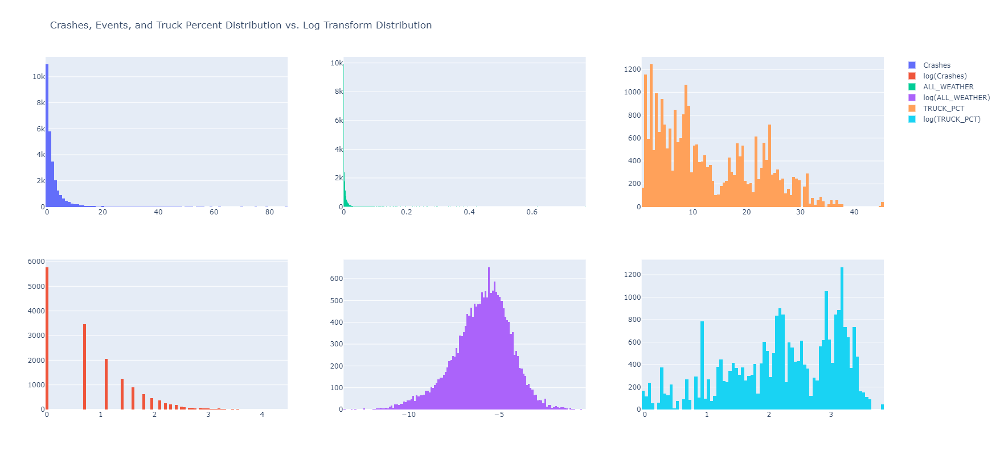

In [3]:
cols, title = ["Crashes","ALL_WEATHER","TRUCK_PCT"], "Crashes, Events, and Truck Percent Distribution vs. Log Transform Distribution"
visualizer.makeHistSubplots(cols, title)

* The weather events column should be log transformed.

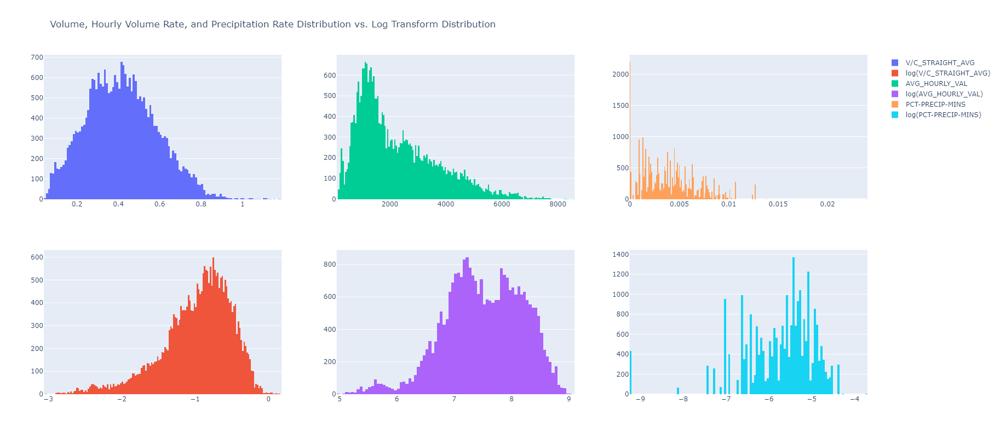

In [4]:
cols = ["V/C_STRAIGHT_AVG", "AVG_HOURLY_VAL", "PCT-PRECIP-MINS"]
title= "Volume, Hourly Volume Rate, and Precipitation Rate Distribution vs. Log Transform Distribution"
visualizer.makeHistSubplots(cols, title)

* The hourly volume and precipitation columns may benefit from a log transform.

### **Exploring how categorical variables affect reliability**

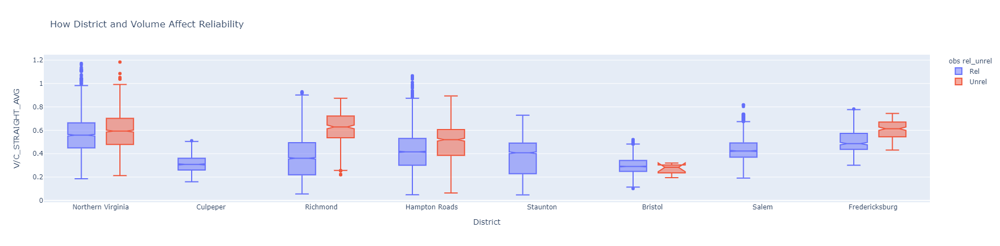

In [5]:
visualizer.makeCatBoxPlots("District", "V/C_STRAIGHT_AVG", "How District and Volume Affect Reliability")

* Culpepper, Staunton, and Salem have no unreliable instances, so we might want to take them out of the dataset.

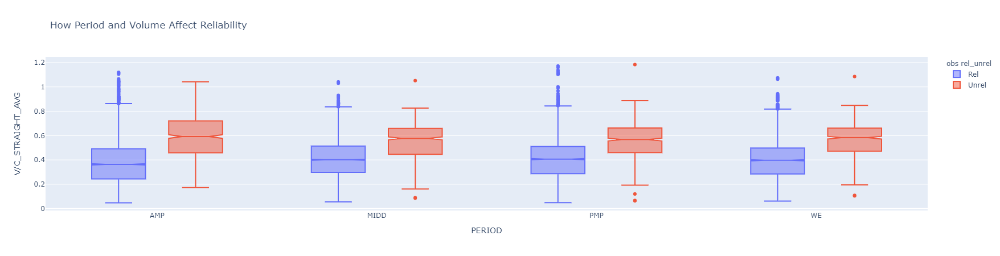

In [6]:
visualizer.makeCatBoxPlots("PERIOD", "V/C_STRAIGHT_AVG", "How Period and Volume Affect Reliability")

* As expected, the AM Peak and the PM Peak (rush hour times) have more unreliable instances.

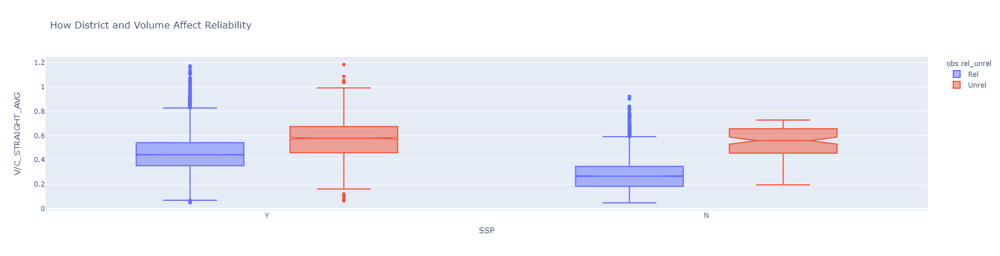

In [7]:
visualizer.makeCatBoxPlots("SSP", "V/C_STRAIGHT_AVG", "How District and Volume Affect Reliability")

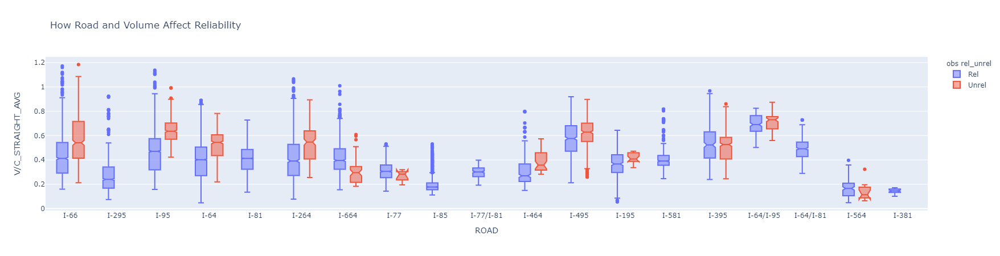

In [8]:
visualizer.makeCatBoxPlots("ROAD", "V/C_STRAIGHT_AVG", "How Road and Volume Affect Reliability")

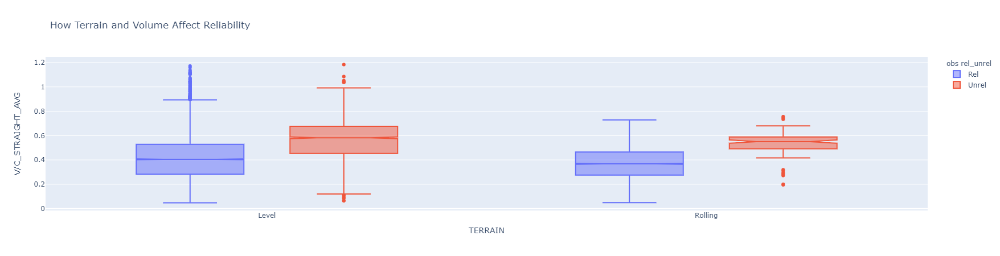

In [9]:
visualizer.makeCatBoxPlots("TERRAIN", "V/C_STRAIGHT_AVG", "How Terrain and Volume Affect Reliability")

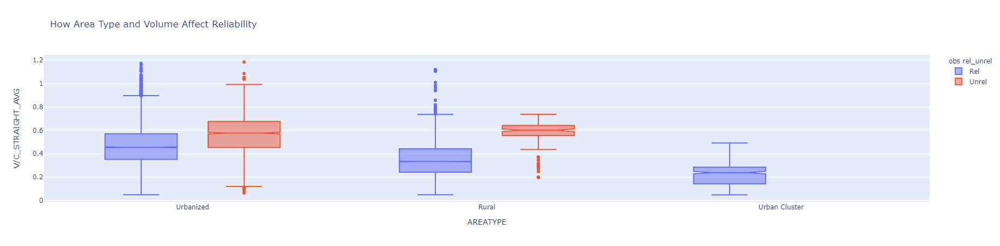

In [10]:
visualizer.makeCatBoxPlots("AREATYPE", "V/C_STRAIGHT_AVG", "How Area Type and Volume Affect Reliability")

### **Map of Highway Segment Reliability**
A mapper helper class was created to help visualize the spatial relationships of the data. The createMapViews() function creates a folium map instance for each combination of year, period, and column.

In [8]:
from Helpers.Mapper_Class import Mapper
mapper = Mapper()
gdf = mapper.getGDF()
mapper.createMapViews(gdf, ['obs rel_unrel', 'Crashes', 'AVG_HOURLY_VAL', 'PCT-PRECIP-MINS'])

/sfs/qumulo/qhome/dbn5eu/ds5110/DS5110_MAP21


### Creating Map Views

Possible Years: [2018 2017 2019 2020]
Possible Periods: ['AMP' 'MIDD' 'PMP' 'WE']
Possible Variables: ['obs rel_unrel', 'Crashes', 'AVG_HOURLY_VAL', 'PCT-PRECIP-MINS']
Creating Views:
- Created: 2018, AMP, obs rel_unrel
- Created: 2018, AMP, Crashes
- Created: 2018, AMP, AVG_HOURLY_VAL
- Created: 2018, AMP, PCT-PRECIP-MINS
- Created: 2018, MIDD, obs rel_unrel
- Created: 2018, MIDD, Crashes
- Created: 2018, MIDD, AVG_HOURLY_VAL
- Created: 2018, MIDD, PCT-PRECIP-MINS
- Created: 2018, PMP, obs rel_unrel
- Created: 2018, PMP, Crashes
- Created: 2018, PMP, AVG_HOURLY_VAL
- Created: 2018, PMP, PCT-PRECIP-MINS
- Created: 2018, WE, obs rel_unrel
- Created: 2018, WE, Crashes
- Created: 2018, WE, AVG_HOURLY_VAL
- Created: 2018, WE, PCT-PRECIP-MINS
- Created: 2017, AMP, obs rel_unrel
- Created: 2017, AMP, Crashes
- Created: 2017, AMP, AVG_HOURLY_VAL
- Created: 2017, AMP, PCT-PRECIP-MINS
- Created: 2017, MIDD, obs rel_unrel
- Created: 2017, MIDD, Crashes
- Created: 2017, MIDD, AVG_HOURLY_VAL
- Cre

#### View The Maps
Note: The viewMaps() functions utilizes ipywidgets and is only visible within a running notebook.

In [10]:
mapper.viewMaps()

interactive(children=(Dropdown(description='year', options=(2018, 2017, 2019, 2020), value=2018), Dropdown(des…

### Reliability during AMP in 2017

In [223]:
mapper.makePeriodByYearMap('AMP', 2017)

/sfs/qumulo/qhome/dbn5eu/ds5110/DS5110_MAP21


Most of the unreliable segments are in Norfalk/Va Beach, Richmond, and Northern Virginia. This isn't surprising considering those three regions make up the most populous areas in Virginia. What's surprising is that there is not a single unreliable segment on I-81. I-81 is one of the nations largest trucking corridors, and the traffic can oftentimes be unpredictable. Perhaps District and Road should be taken out of the analysis - we only use numeric and non geographic defining categorical variables.

---

## Perform Transformations

Below we consider whether or not to remove rows for Districts where there are no Unreliable instances. 

In [12]:
from pyspark.sql import SparkSession, SQLContext

# create spark session
spark2 = SparkSession \
        .builder \
        .appName("MAP-21_sc2") \
        .getOrCreate()
sc2 = SQLContext(spark2)

In [13]:
# convert trainableData back to Spark
trainableDataSpark=spark2.createDataFrame(trainableData)

# remove observations of Staunton Culpeper and Salem
trainableDataSpark_filter = trainableDataSpark.filter((trainableDataSpark.District != "Staunton") & (trainableDataSpark.District != "Culpeper") & (trainableDataSpark.District != "Salem"))
trainableDataSpark_filter.count()

20352

After removing rows where the District is equal to either Staunton, Culpeper, or Salem, we are left with 20,352. Since our trainable data set is not incredibly large to begin with, we instead decide to move ahead with all 27,312 rows - instead dropping the District and Road variables. This means we will continue on with only numeric and non georgraphic defining categorical variables. 

We decided on the schema of the final trainable data and implemented it by log transforming the ALL_WEATHER, AVG_HOURLY_VAL, and PCT-PRECIP-MINS columns, and dropping the District and Road columns.

In [14]:
import pyspark.sql.functions as f
trainableDataSpark = trainableDataSpark.withColumn("ALL_WEATHER", f.col("ALL_WEATHER") + f.lit(0.000001))
trainableDataSpark = trainableDataSpark.withColumn("AVG_HOURLY_VAL", f.col("AVG_HOURLY_VAL") + f.lit(0.000001))
trainableDataSpark = trainableDataSpark.withColumn("PCT-PRECIP-MINS", f.col("PCT-PRECIP-MINS") + f.lit(0.000001))
trainableDataSpark = trainableDataSpark.withColumn("ALL_WEATHER_LOG", f.log(trainableDataSpark["ALL_WEATHER"]) )
trainableDataSpark = trainableDataSpark.withColumn("AVG_HOURLY_VAL_LOG", f.log(trainableDataSpark["AVG_HOURLY_VAL"]) )
trainableDataSpark = trainableDataSpark.withColumn("PCT-PRECIP-MINS_LOG", f.log(trainableDataSpark["PCT-PRECIP-MINS"]) )
trainableDataSpark = trainableDataSpark.drop("Unnamed: 0","District","ROAD","ALL_WEATHER","AVG_HOURLY_VAL","PCT-PRECIP-MINS")
trainableDataSpark.printSchema()
trainableDataSpark.count()

root
 |-- TMC: string (nullable = true)
 |-- YEAR: long (nullable = true)
 |-- PERIOD: string (nullable = true)
 |-- V/C_STRAIGHT_AVG: double (nullable = true)
 |-- SSP: string (nullable = true)
 |-- Crashes: long (nullable = true)
 |-- lanes: long (nullable = true)
 |-- County: string (nullable = true)
 |-- AREATYPE: string (nullable = true)
 |-- TERRAIN: string (nullable = true)
 |-- DIR: string (nullable = true)
 |-- ROAD_DIR: string (nullable = true)
 |-- INTERSECTION: string (nullable = true)
 |-- ROAD_ORDER: double (nullable = true)
 |-- GLOBAL_ORDER: long (nullable = true)
 |-- TRUCK_PCT: double (nullable = true)
 |-- obs rel_unrel: string (nullable = true)
 |-- ALL_WEATHER_LOG: double (nullable = true)
 |-- AVG_HOURLY_VAL_LOG: double (nullable = true)
 |-- PCT-PRECIP-MINS_LOG: double (nullable = true)



27312

## Building Pipeline

Building a pipeline allowed us to easily tweak and rerun the pipeline, as well as reduce the clutter in the code. The pipeline uses a StringIndexer and OneHotEncoder on the categorical variables, and a VectorAssembler to create the 'features' columns.

In [16]:
from pyspark.ml import Pipeline
from pyspark.ml.feature import StringIndexer, OneHotEncoder, VectorAssembler

In [17]:
# cols for StringIndexer
stringCols = ['PERIOD','SSP','County','AREATYPE','TERRAIN','DIR','ROAD_DIR','INTERSECTION','obs rel_unrel']
outputStringCols = ['PERIODIndex','SSPIndex','CountyIndex','AREATYPEIndex','TERRAINIndex','DIRIndex','ROAD_DIRIndex','INTERSECTIONIndex','label']

# cols for OneHotEncoder
encodeCols = ['PERIODIndex','SSPIndex','CountyIndex','AREATYPEIndex','TERRAINIndex','DIRIndex','ROAD_DIRIndex','INTERSECTIONIndex']
outputEncodeCols = ['PERIODIndexEncoder','SSPIndexEncoder','CountyIndexEncoder','AREATYPEIndexEncoder','TERRAINIndexEncoder','DIRIndexEncoder','ROAD_DIRIndexEncoder','INTERSECTIONIndexEncoder']

# All cols going into features
assembleCols = ["YEAR","PERIODIndexEncoder", "V/C_STRAIGHT_AVG", "SSPIndexEncoder","Crashes","lanes","CountyIndexEncoder","AREATYPEIndexEncoder","TERRAINIndexEncoder","DIRIndex","ROAD_DIRIndexEncoder","INTERSECTIONIndexEncoder","ROAD_ORDER","GLOBAL_ORDER","TRUCK_PCT","AVG_HOURLY_VAL_LOG"]

# create stage objects
stringIndexer = StringIndexer(inputCols=stringCols, outputCols=outputStringCols)
encoder = OneHotEncoder(inputCols=encodeCols, outputCols=outputEncodeCols)
assembler = VectorAssembler(inputCols=assembleCols, outputCol="features")

# create pipeline
pipeline = Pipeline(stages=[stringIndexer,encoder,assembler])

# output the formatted data
formatted_data = pipeline.fit(trainableDataSpark).transform(trainableDataSpark)
formatted_data.select(['TMC','label','features']).show()

+---------+-----+--------------------+
|      TMC|label|            features|
+---------+-----+--------------------+
|110+04170|  0.0|(576,[0,1,4,5,7,1...|
|110+04170|  0.0|(576,[0,2,4,5,7,1...|
|110+04170|  0.0|(576,[0,3,4,5,7,1...|
|110+04170|  0.0|(576,[0,4,5,6,7,1...|
|110+04193|  0.0|(576,[0,1,4,6,7,3...|
|110+04193|  0.0|(576,[0,2,4,6,7,3...|
|110+04193|  0.0|(576,[0,3,4,6,7,3...|
|110+04193|  0.0|(576,[0,4,6,7,31,...|
|110+04770|  0.0|(576,[0,1,4,7,32,...|
|110+04770|  0.0|(576,[0,2,4,6,7,3...|
|110+04770|  0.0|(576,[0,3,4,7,32,...|
|110+04770|  0.0|(576,[0,4,7,32,67...|
|110+04788|  0.0|(576,[0,1,4,5,6,7...|
|110+04788|  0.0|(576,[0,2,4,5,6,7...|
|110+04788|  0.0|(576,[0,3,4,5,6,7...|
|110+04788|  0.0|(576,[0,4,5,7,9,6...|
|110+04789|  0.0|(576,[0,1,4,5,7,9...|
|110+04789|  0.0|(576,[0,2,4,5,7,9...|
|110+04789|  0.0|(576,[0,3,4,5,6,7...|
|110+04789|  0.0|(576,[0,4,5,6,7,9...|
+---------+-----+--------------------+
only showing top 20 rows



## Split Data into Train and Test Sets

Randomly split data into 90% training and 10% testing sets. This split was decided on because of the relatively small amount of observations.

In [18]:
train, test = preprocessor.splitData(formatted_data)

# Model Construction

All models were run using 10-fold cross-validation and thresholds set at 0.5. Then additional thresholds were tested after determining the optimal tuning parameters.

In [19]:
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.mllib.evaluation import BinaryClassificationMetrics, MulticlassMetrics
from pyspark.sql.types import FloatType, DoubleType
import matplotlib.pyplot as plt

In [55]:
# evaluator that will be used for all models and cross validation
evaluator = BinaryClassificationEvaluator(rawPredictionCol="prediction",
                                      labelCol="label",
                                      metricName='areaUnderROC')

# function to return the wanted metrics of a model
def getMetrics(modeldfname):
    
    model = globals()[modeldfname]

    # calculate rates, accuracy, and auroc
    tp = model[(model.label == 1) & (model.prediction == 1)].count()
    tn = model[(model.label == 0) & (model.prediction == 0)].count()
    fp = model[(model.label == 0) & (model.prediction == 1)].count()
    fn = model[(model.label == 1) & (model.prediction == 0)].count()
    
    _tp = round(tp/(tp+fn),4)
    _tn = round(tn/(tn+fp),4)
    _fp = round(fp/(tn+fp),4)
    _fn = round(fn/(tp+fn),4)
    accuracy = round(((tp + tn)/model.count()), 5)
    auroc = round(evaluator.evaluate(model), 5)
    
    # output dataframe
    metrics = spark2.createDataFrame([(modeldfname,_tp,_tn,_fp,_fn,accuracy,auroc)],['model','TP','TN','FP','FN','Accuracy','AUROC'])
    return metrics

# function to test varying thresholds for predictions
def testThresholds(modeldf):
    
    # pull the probability from the the probability vector
    probRel=f.udf(lambda v:float(v[1]),FloatType())
    tempModeldf = modeldf.withColumn('probRel', probRel(f.col("probability")))
    
    _thres, _tp, _tn, _fp, _fn, _accuracy, _auroc = [], [], [], [], [], [], []
    
    # test each threshold and return the wanted metrics
    for thres in [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]:
        temp = tempModeldf.withColumn('prediction_new', f.when(f.col('probRel') >= thres, 1).otherwise(0).cast(DoubleType()))
        temp = temp.select('label', f.col('prediction_new').alias("prediction"))
        
        # calculate rates, accuracy, and auroc
        tp = temp[(temp.label == 1) & (temp.prediction == 1)].count()
        tn = temp[(temp.label == 0) & (temp.prediction == 0)].count()
        fp = temp[(temp.label == 0) & (temp.prediction == 1)].count()
        fn = temp[(temp.label == 1) & (temp.prediction == 0)].count()
        _thres.append(thres)
        _tp.append(round(tp/(tp+fn),4))
        _tn.append(round(tn/(tn+fp),4))
        _fp.append(round(fp/(tn+fp),4))
        _fn.append(round(fn/(tp+fn),4))
        _accuracy.append(round(((tp + tn)/temp.count()), 5))
        _auroc.append(round(evaluator.evaluate(temp), 5))
    
    # return dataframe of threshold performances
    thresMetrics = spark2.createDataFrame(zip(_thres,_tp,_tn,_fp,_fn,_accuracy,_auroc),
                                          ['Threshold','TP','TN','FP','FN','Accuracy','AUROC']).sort(f.col('AUROC').desc())
    
    return thresMetrics

# function to plot an ROC curve from of a model
def plotROC(bestModel):
    plt.figure(figsize=(5,5))
    plt.plot([0, 1], [0, 1], 'r--')
    plt.plot(bestModel.summary.roc.select('FPR').collect(),
             bestModel.summary.roc.select('TPR').collect())
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.show()

### Single Logistic Regression Model
We started with a single logistic regression model to act as a loose baseline of predictability

In [62]:
# build and train model
lr = LogisticRegression(featuresCol = 'features', labelCol = 'label').setThreshold(0.5)
lrModel = lr.fit(train)

In [230]:
# predict the test set
lrPred = lrModel.transform(test)

In [33]:
getMetrics('lrPred').show()

+------+-----+-----+-----+-----+--------+-----+
| model|   TP|   TN|   FP|   FN|Accuracy|AUROC|
+------+-----+-----+-----+-----+--------+-----+
|lrPred|0.578|0.962|0.038|0.422|  0.9217| 0.77|
+------+-----+-----+-----+-----+--------+-----+



In [71]:
# test thresholds
testThresholds(lrPred).show()

+---------+------+------+------+------+--------+-------+
|Threshold|    TP|    TN|    FP|    FN|Accuracy|  AUROC|
+---------+------+------+------+------+--------+-------+
|      0.1|0.9689|0.8502|0.1498|0.0311| 0.86271|0.90954|
|      0.2|0.9377|0.8787|0.1213|0.0623| 0.88492|0.90822|
|      0.3|0.8339|0.9072|0.0928|0.1661| 0.89949|0.87056|
|      0.4|0.7232|0.9406|0.0594|0.2768|  0.9177|0.83188|
|      0.5|0.5779|0.9621|0.0379|0.4221|  0.9217|   0.77|
|      0.6|0.3945|0.9764|0.0236|0.6055| 0.91515|0.68543|
|      0.7|0.2872|0.9866|0.0134|0.7128| 0.91296|0.63688|
|      0.8| 0.128|0.9967|0.0033| 0.872| 0.90532|0.56239|
|      0.9|0.0311|   1.0|   0.0|0.9689| 0.89803|0.51557|
+---------+------+------+------+------+--------+-------+



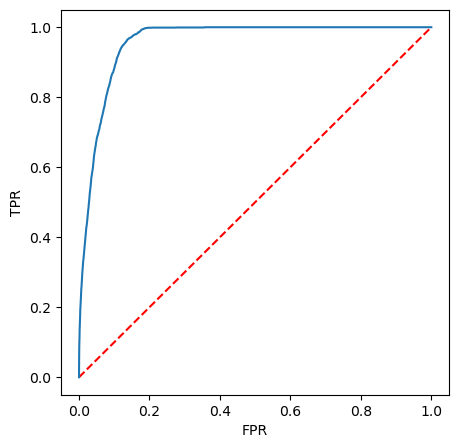

In [25]:
# plot ROC curve
plotROC(lrModel)

### Logistic Regression with CV and Tuning
We decided to implement CV and tuning parameters to better fit the logistic regression model

In [37]:
%%time
# param grid
lrParamGrid = (ParamGridBuilder() \
             .addGrid(lr.regParam, [0.01, 0.5, 2.0]) \
             .addGrid(lr.elasticNetParam, [0.0, 0.2, 0.5, 0.8, 1.0]) \
             .addGrid(lr.maxIter, [1, 5, 10]) \
             .build())

# cross validator
lrCrossVal = CrossValidator(estimator = lr,
                            estimatorParamMaps = lrParamGrid,
                            evaluator = evaluator,
                            numFolds = 10,
                            seed=314)

# train the model
lrCrossValModel = lrCrossVal.fit(train)

CPU times: user 17.2 s, sys: 4.82 s, total: 22 s
Wall time: 5min 43s


In [58]:
# predict the test set
lrCrossValPred = lrCrossValModel.transform(test)

print("RegParam:", lrCrossValModel.bestModel._java_obj.getRegParam())
print("Max Iterations:", lrCrossValModel.bestModel._java_obj.getMaxIter())
print("ElasticNetParam:", lrCrossValModel.bestModel._java_obj.getElasticNetParam())

modelMetrics = getMetrics('lrCrossValPred')
modelMetrics.show()

RegParam: 0.01
Max Iterations: 10
ElasticNetParam: 0.2
+--------------+------+-----+-----+------+--------+-------+
|         model|    TP|   TN|   FP|    FN|Accuracy|  AUROC|
+--------------+------+-----+-----+------+--------+-------+
|lrCrossValPred|0.3426|0.978|0.022|0.6574| 0.91114|0.66029|
+--------------+------+-----+-----+------+--------+-------+



In [72]:
# test thresholds
lrThres = testThresholds(lrCrossValPred)
lrThres.show()

+---------+------+------+------+------+--------+-------+
|Threshold|    TP|    TN|    FP|    FN|Accuracy|  AUROC|
+---------+------+------+------+------+--------+-------+
|      0.1|0.9343|0.8112|0.1888|0.0657| 0.82411| 0.8727|
|      0.2| 0.737|0.9039|0.0961| 0.263| 0.88638|0.82049|
|      0.3|0.5536|0.9426|0.0574|0.4464| 0.90168|0.74812|
|      0.4|0.4567|0.9654|0.0346|0.5433| 0.91187|0.71108|
|      0.5|0.3426| 0.978| 0.022|0.6574| 0.91114|0.66029|
|      0.6|0.2111|0.9878|0.0122|0.7889| 0.90605|0.59943|
|      0.7|0.0934|0.9959|0.0041|0.9066| 0.90095|0.54468|
|      0.8|0.0311|0.9988|0.0012|0.9689| 0.89694|0.51496|
|      0.9|0.0035|   1.0|   0.0|0.9965| 0.89512|0.50173|
+---------+------+------+------+------+--------+-------+



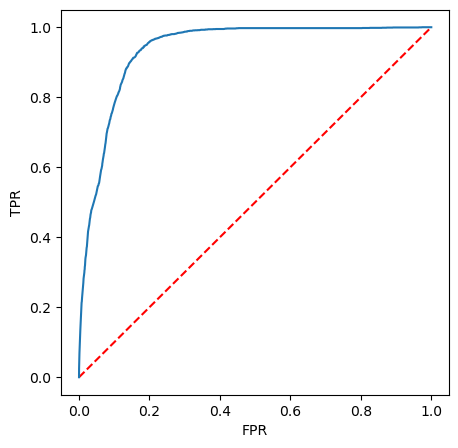

In [40]:
# plot ROC curve
plotROC(lrCrossValModel.bestModel)

- We believe the best option was a threshold of 0.4, where false positives did not increase severely, but the AUROC would go up to 0.71

## Random Forest

The second model we trained was random forest. At each tree split, a random subset of the predictors is chosen. This method gives less strong variables more of a chance to have an influence.

In [45]:
from pyspark.ml.classification import RandomForestClassifier

In [46]:
%%time
# build the model
rf = RandomForestClassifier(labelCol='label', featuresCol='features').setThresholds([0.5,0.5])

# param grid
rfParamGrid = (ParamGridBuilder() \
               .addGrid(rf.maxDepth, [2, 5, 10]) \
               .addGrid(rf.maxBins, [10, 15, 20]) \
               .addGrid(rf.numTrees, [5, 20, 50]) \
               .build())

# cross validator
rfCrossVal = CrossValidator(estimator = rf,
                          estimatorParamMaps = rfParamGrid,
                          evaluator = evaluator,
                          numFolds = 10,
                          seed=314)

# train the model
rfCrossValModel = rfCrossVal.fit(train)

CPU times: user 12.4 s, sys: 3.47 s, total: 15.9 s
Wall time: 7min 17s


In [59]:
# predict the test set
rfCrossValPred = rfCrossValModel.transform(test)

print("Max Depth:", rfCrossValModel.bestModel._java_obj.getMaxDepth())
print("Max Bins:", rfCrossValModel.bestModel._java_obj.getMaxBins())
print("Num Trees:", rfCrossValModel.bestModel._java_obj.getNumTrees())
print("Feature Subset Strategy:", rfCrossValModel.bestModel._java_obj.getFeatureSubsetStrategy())

modelMetrics = modelMetrics.union(getMetrics('rfCrossValPred'))
modelMetrics.show()

Max Depth: 10
Max Bins: 10
Num Trees: 5
Feature Subset Strategy: auto
+--------------+------+------+------+------+--------+-------+
|         model|    TP|    TN|    FP|    FN|Accuracy|  AUROC|
+--------------+------+------+------+------+--------+-------+
|lrCrossValPred|0.3426| 0.978| 0.022|0.6574| 0.91114|0.66029|
|rfCrossValPred| 0.083|0.9996|4.0E-4| 0.917| 0.90313|0.54132|
+--------------+------+------+------+------+--------+-------+



In [73]:
# test thresholds
rfThres = testThresholds(rfCrossValPred)
rfThres.show()

+---------+------+------+------+------+--------+-------+
|Threshold|    TP|    TN|    FP|    FN|Accuracy|  AUROC|
+---------+------+------+------+------+--------+-------+
|      0.2|0.7889|0.8596|0.1404|0.2111| 0.85215|0.82426|
|      0.1|0.9827|0.6227|0.3773|0.0173|  0.6606| 0.8027|
|      0.3|0.5571|0.9573|0.0427|0.4429| 0.91515|0.75718|
|      0.4|0.1972|0.9923|0.0077|0.8028| 0.90859|0.59475|
|      0.5| 0.083|0.9996|4.0E-4| 0.917| 0.90313|0.54132|
|      0.6|0.0415|   1.0|   0.0|0.9585| 0.89913|0.52076|
|      0.7|0.0173|   1.0|   0.0|0.9827| 0.89658|0.50865|
|      0.8|   0.0|   1.0|   0.0|   1.0| 0.89476|    0.5|
|      0.9|   0.0|   1.0|   0.0|   1.0| 0.89476|    0.5|
+---------+------+------+------+------+--------+-------+



- We believed the best threshold for this model was also 0.4, with an AUROC of 0.59 and accuracy of 0.91 because of the relatively low false positive rate.

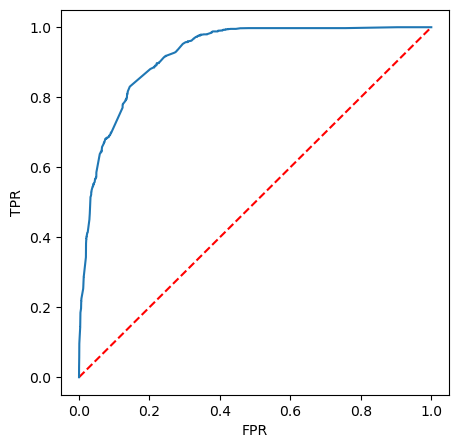

In [49]:
# plot ROC curve
plotROC(rfCrossValModel.bestModel)

## Decision Tree

After seeing the performance of the random forest model, we wondered how a simple decision tree model would perform on the same data. It was possible that certain predictors played a bigger role in segments being unreliable or not, and we were suppressing that influence.

In [50]:
from pyspark.ml.classification import DecisionTreeClassifier

In [51]:
%%time
# build the model
dt = DecisionTreeClassifier(labelCol='label', featuresCol='features').setThresholds([0.5,0.5])

# param grid
dtParamGrid = (ParamGridBuilder() \
               .addGrid(dt.maxDepth, [2, 5, 10]) \
               .addGrid(dt.maxBins, [10, 20]) \
               .build())

# cross validator
dtCrossVal = CrossValidator(estimator = dt,
                          estimatorParamMaps = dtParamGrid,
                          evaluator = evaluator,
                          numFolds = 10,
                          seed=314)

# train the model
dtCrossValModel = dtCrossVal.fit(train)

CPU times: user 2.5 s, sys: 650 ms, total: 3.15 s
Wall time: 1min 15s


In [60]:
# predict the test set
dtCrossValPred = dtCrossValModel.transform(test)

print("Max Depth:", dtCrossValModel.bestModel._java_obj.getMaxDepth())
print("Max Bins:", dtCrossValModel.bestModel._java_obj.getMaxBins())

modelMetrics = modelMetrics.union(getMetrics('dtCrossValPred'))
modelMetrics.show()

Max Depth: 10
Max Bins: 20
+--------------+------+------+------+------+--------+-------+
|         model|    TP|    TN|    FP|    FN|Accuracy|  AUROC|
+--------------+------+------+------+------+--------+-------+
|lrCrossValPred|0.3426| 0.978| 0.022|0.6574| 0.91114|0.66029|
|rfCrossValPred| 0.083|0.9996|4.0E-4| 0.917| 0.90313|0.54132|
|dtCrossValPred|0.6886| 0.978| 0.022|0.3114| 0.94756| 0.8333|
+--------------+------+------+------+------+--------+-------+



In [74]:
# test thresholds
dtThres = testThresholds(dtCrossValPred)
dtThres.show()

+---------+------+------+------+------+--------+-------+
|Threshold|    TP|    TN|    FP|    FN|Accuracy|  AUROC|
+---------+------+------+------+------+--------+-------+
|      0.1|0.8028|0.9007|0.0993|0.1972| 0.89039|0.85173|
|      0.2| 0.699|0.9735|0.0265| 0.301| 0.94465|0.83625|
|      0.3| 0.692|0.9776|0.0224| 0.308| 0.94756|0.83483|
|      0.5|0.6886| 0.978| 0.022|0.3114| 0.94756| 0.8333|
|      0.4|0.6886| 0.978| 0.022|0.3114| 0.94756| 0.8333|
|      0.6|0.4983|0.9943|0.0057|0.5017|  0.9421|0.74629|
|      0.7|0.4844|0.9959|0.0041|0.5156|  0.9421|0.74018|
|      0.8| 0.474|0.9959|0.0041| 0.526| 0.94101|0.73499|
|      0.9|0.4152|0.9984|0.0016|0.5848|   0.937| 0.7068|
+---------+------+------+------+------+--------+-------+



- We found that the best thresholds were between 0.5 and 0.2, where the AUROC, accuracy, and false positives remained relatively unchanged. From this we decided changing the threshold from 0.5 did not add any benefit.

Because the DecisionTreeClassificationModel does not provide a summary attribute, our plotROC method would not work. We found an alternative way to plot the curve for this model online (source: https://newbedev.com/pyspark-extract-roc-curve)

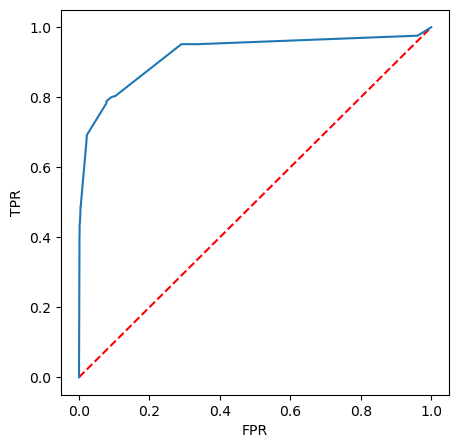

In [217]:
# plot ROC curve
# function taken from source above
class CurveMetrics(BinaryClassificationMetrics):
    def __init__(self, *args):
        super(CurveMetrics, self).__init__(*args)

    def _to_list(self, rdd):
        points = []
        for row in rdd.collect():
            points += [(float(row._1()), float(row._2()))]
        return points

    def get_curve(self, method):
        rdd = getattr(self._java_model, method)().toJavaRDD()
        return self._to_list(rdd)

# pull the predictions
preds = dtCrossValPred.select('label','probability').rdd.map(lambda row: (float(row['probability'][1]), float(row['label'])))

# get curve values
points = CurveMetrics(preds).get_curve('roc')

# plot
plt.figure(figsize=(5,5))
plt.plot([0, 1], [0, 1], 'r--')
plt.plot([x[0] for x in points],
         [x[1] for x in points])
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.show()

### Select the best model

Although the decision tree model did not have the lowest false positive rate, it did have noticeably better accuracy and AUROC values. the We decided to move forward with the decision tree model due to its ability to perform well in Accuracy and AUROC while maintaining a reasonable false positive rate. 

In [85]:
# create dataframe of selected models
selectedModels = lrThres.filter('Threshold == 0.4').withColumn('Model',f.lit('LR')) \
    .union(rfThres.filter('Threshold == 0.4').withColumn('Model',f.lit('RF'))) \
    .union(dtThres.filter('Threshold == 0.5').withColumn('Model',f.lit('DT'))) \
    .select('Model','Threshold','TP','TN','FP','FN','Accuracy','AUROC')

selectedModels.show()

+-----+---------+------+------+------+------+--------+-------+
|Model|Threshold|    TP|    TN|    FP|    FN|Accuracy|  AUROC|
+-----+---------+------+------+------+------+--------+-------+
|   LR|      0.4|0.4567|0.9654|0.0346|0.5433| 0.91187|0.71108|
|   RF|      0.4|0.1972|0.9923|0.0077|0.8028| 0.90859|0.59475|
|   DT|      0.5|0.6886| 0.978| 0.022|0.3114| 0.94756| 0.8333|
+-----+---------+------+------+------+------+--------+-------+



## Apply 'Best Model' to Forecasted Data

We previously held out forecasted data from the Virginia Department of Transportation for the years 2021-2024. We will now apply the Decision Tree model that was found to have the highest accuracy and AUROC to this forecasted data set. The goal here is for our model to flag future unreliable highway segments for the state of Virginia so that they can direct their attention to programs that will improve the reliability of these segments. 

We applied the same transformations to the forecasted data as the trainable data.

In [86]:
forecastedData= pd.read_csv("Data/Final_Data/forecastedData.csv")
forecastedDataSpark=spark2.createDataFrame(forecastedData)
forecastedDataSpark = forecastedDataSpark.withColumn("ALL_WEATHER", f.col("ALL_WEATHER") + f.lit(0.000001))
forecastedDataSpark = forecastedDataSpark.withColumn("AVG_HOURLY_VAL", f.col("AVG_HOURLY_VAL") + f.lit(0.000001))
forecastedDataSpark = forecastedDataSpark.withColumn("PCT-PRECIP-MINS", f.col("PCT-PRECIP-MINS") + f.lit(0.000001))
forecastedDataSpark = forecastedDataSpark.withColumn("ALL_WEATHER_LOG", f.log(forecastedDataSpark["ALL_WEATHER"]) )
forecastedDataSpark = forecastedDataSpark.withColumn("AVG_HOURLY_VAL_LOG", f.log(forecastedDataSpark["AVG_HOURLY_VAL"]) )
forecastedDataSpark = forecastedDataSpark.withColumn("PCT-PRECIP-MINS_LOG", f.log(forecastedDataSpark["PCT-PRECIP-MINS"]) )
forecastedDataSpark = forecastedDataSpark.drop("Unnamed: 0","District","ROAD","ALL_WEATHER","AVG_HOURLY_VAL","PCT-PRECIP-MINS")
forecastedDataSpark.printSchema()
forecastedDataSpark.count()

root
 |-- TMC: string (nullable = true)
 |-- PERIOD: string (nullable = true)
 |-- YEAR: long (nullable = true)
 |-- V/C_STRAIGHT_AVG: double (nullable = true)
 |-- SSP: string (nullable = true)
 |-- Crashes: double (nullable = true)
 |-- lanes: long (nullable = true)
 |-- County: string (nullable = true)
 |-- AREATYPE: string (nullable = true)
 |-- TERRAIN: string (nullable = true)
 |-- DIR: string (nullable = true)
 |-- ROAD_DIR: string (nullable = true)
 |-- INTERSECTION: string (nullable = true)
 |-- ROAD_ORDER: double (nullable = true)
 |-- GLOBAL_ORDER: long (nullable = true)
 |-- TRUCK_PCT: double (nullable = true)
 |-- ALL_WEATHER_LOG: double (nullable = true)
 |-- AVG_HOURLY_VAL_LOG: double (nullable = true)
 |-- PCT-PRECIP-MINS_LOG: double (nullable = true)



27312

### Run Forecasted Data Through Pipeline

We first must run the forecasted data through a pipeline of StringIndexer, OneHotEncoder, and Vector Assembler in the same way that we did our historical, trainable data set. 

In [87]:
# cols for StringIndexer
stringCols_forecast = ['PERIOD','SSP','County','AREATYPE','TERRAIN','DIR','ROAD_DIR','INTERSECTION']
outputStringCols_forecast = ['PERIODIndex','SSPIndex','CountyIndex','AREATYPEIndex','TERRAINIndex','DIRIndex','ROAD_DIRIndex','INTERSECTIONIndex']

# cols for OneHotEncoder
encodeCols_forecast = ['PERIODIndex','SSPIndex','CountyIndex','AREATYPEIndex','TERRAINIndex','DIRIndex','ROAD_DIRIndex','INTERSECTIONIndex']
outputEncodeCols_forecast = ['PERIODIndexEncoder','SSPIndexEncoder','CountyIndexEncoder','AREATYPEIndexEncoder','TERRAINIndexEncoder','DIRIndexEncoder','ROAD_DIRIndexEncoder','INTERSECTIONIndexEncoder']

# cols for features
assembleCols_forecast = ["YEAR","PERIODIndexEncoder", "V/C_STRAIGHT_AVG", "SSPIndexEncoder","Crashes","lanes","CountyIndexEncoder","AREATYPEIndexEncoder","TERRAINIndexEncoder","DIRIndex","ROAD_DIRIndexEncoder","INTERSECTIONIndexEncoder","ROAD_ORDER","GLOBAL_ORDER","TRUCK_PCT","AVG_HOURLY_VAL_LOG"]

# pipeline stages
stringIndexer_forecast = StringIndexer(inputCols=stringCols_forecast, outputCols=outputStringCols_forecast)
encoder_forecast = OneHotEncoder(inputCols=encodeCols_forecast, outputCols=outputEncodeCols_forecast)
assembler_forecast = VectorAssembler(inputCols=assembleCols_forecast, outputCol="features")

# build pipeline
pipeline_forecast = Pipeline(stages=[stringIndexer_forecast,encoder_forecast,assembler_forecast])

# generate forcasted data
forecasted_data = pipeline_forecast.fit(forecastedDataSpark).transform(forecastedDataSpark)
forecasted_data.select(['features']).show()

+--------------------+
|            features|
+--------------------+
|(576,[0,1,4,5,6,7...|
|(576,[0,2,4,5,6,7...|
|(576,[0,3,4,5,6,7...|
|(576,[0,4,5,6,7,1...|
|(576,[0,1,4,5,6,7...|
|(576,[0,2,4,5,6,7...|
|(576,[0,3,4,5,6,7...|
|(576,[0,4,5,6,7,8...|
|(576,[0,1,4,5,6,7...|
|(576,[0,2,4,5,6,7...|
|(576,[0,3,4,5,6,7...|
|(576,[0,4,5,6,7,1...|
|(576,[0,1,4,5,6,7...|
|(576,[0,2,4,5,6,7...|
|(576,[0,3,4,5,6,7...|
|(576,[0,4,5,6,7,3...|
|(576,[0,1,4,5,6,7...|
|(576,[0,2,4,5,6,7...|
|(576,[0,3,4,5,6,7...|
|(576,[0,4,5,6,7,2...|
+--------------------+
only showing top 20 rows



### Run formatted data through model, print probability and prediction

In [88]:
dtCrossValPred_forecast = dtCrossValModel.bestModel.transform(forecasted_data)
dtCrossValPred_forecast.select('prediction').show(5,truncate=False)

+----------+
|prediction|
+----------+
|0.0       |
|0.0       |
|0.0       |
|0.0       |
|0.0       |
+----------+
only showing top 5 rows



In [89]:
# show prediction counts
dtCrossValPred_forecast.groupby('prediction').count().show()

+----------+-----+
|prediction|count|
+----------+-----+
|       0.0|26098|
|       1.0| 1214|
+----------+-----+



- We predicted a total of 1214 segments as unreliable over the 4 years and 4 periods.

In [90]:
# show prediction counts by year
dtCrossValPred_forecast.groupby('YEAR','prediction').count().sort('YEAR','prediction').show()

+----+----------+-----+
|YEAR|prediction|count|
+----+----------+-----+
|2021|       0.0| 6527|
|2021|       1.0|  301|
|2022|       0.0| 6525|
|2022|       1.0|  303|
|2023|       0.0| 6524|
|2023|       1.0|  304|
|2024|       0.0| 6522|
|2024|       1.0|  306|
+----+----------+-----+



In [93]:
# Show count of TMCs with X amount of periods of unreliability
dt_TMC_Year = dtCrossValPred_forecast.groupby('TMC', 'Year').sum('prediction')
dt_Unreliable_Count = dt_TMC_Year.groupby('Year', 'sum(prediction)').count().sort('Year', 'sum(prediction)')
dt_Unreliable_Count.show()

+----+---------------+-----+
|Year|sum(prediction)|count|
+----+---------------+-----+
|2021|            0.0| 1601|
|2021|            1.0|   30|
|2021|            2.0|    7|
|2021|            3.0|   19|
|2021|            4.0|   50|
|2022|            0.0| 1598|
|2022|            1.0|   33|
|2022|            2.0|    8|
|2022|            3.0|   18|
|2022|            4.0|   50|
|2023|            0.0| 1598|
|2023|            1.0|   32|
|2023|            2.0|    9|
|2023|            3.0|   18|
|2023|            4.0|   50|
|2024|            0.0| 1597|
|2024|            1.0|   32|
|2024|            2.0|   10|
|2024|            3.0|   18|
|2024|            4.0|   50|
+----+---------------+-----+



- In order for a segment to be reliable, it needs to be reliable for all four periods of the day. So, any segment marked unreliable for at least one period is considered unreliable.

## Conclusion

The Decision Tree model projected an average of 136 highway segments to be unreliable each year from 2021-2024.The primary goal of our project was to identify future unreliable highway segments for VDOT. According to the state, an unreliable segment must only be classified by a model as unreliable in either the morning, midday, evening, or weekend to be considered unreliable. Our decision tree model has identified on average 136 segments that are projected to be unreliable each year from 2021-2024. We believe these segments should be prioritized when allocating MAP-21 funds to highway improvements.

### Map of classifications

View the forecasted classifications by year (all years but 2021 left commented out due to the increased size of the file if included)

In [218]:
import geopandas as gpd

# TMC segment shapefile
shp = gpd.read_file("Data/Virginia2020/Virginia.shp")

# create geodataframe for mapping
forecasted = dt_TMC_Year.toPandas()
forecasted = shp[['Tmc','geometry']].merge(forecasted, right_on='TMC', left_on='Tmc').drop('TMC', axis=1)

# create rel_unrel column
forecasted.loc[forecasted['sum(prediction)'] == 0, 'rel_unrel'] = 'rel'
forecasted.rel_unrel = forecasted.rel_unrel.fillna('unrel')

In [224]:
# plot the predicted reliability of 2021
mapper.quickMap(forecasted.loc[forecasted.Year==2021], 'rel_unrel')

In [225]:
#mapper.quickMap(forecasted.loc[forecasted.Year==2022], 'rel_unrel')

In [226]:
#mapper.quickMap(forecasted.loc[forecasted.Year==2023], 'rel_unrel')

In [227]:
#mapper.quickMap(forecasted.loc[forecasted.Year==2024], 'rel_unrel')